Aim of this notebook is to look at calibrated stereo images and to visualize some mathematical properties of pairs of matched keypoints, found by opencv sift algorithms or our pysift implementation.


Imports


In [1]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import os
import sys

# add the path to the visualize_hessian folder
sys.path.append(os.path.join("..", "code"))

import visu_hessian as vh
import descriptor as desc
import visu_descriptor as visu_desc

# return to the root directory
sys.path.append(os.path.join(".."))

sys.path.append(os.path.join("matching"))
from matching.matching import get_keypoint_pairs
from matching.saving import (
    save_keypoints,
    save_matches,
    save_kp_pairs_to_arr,
    load_matches,
    load_keypoints,
)

# return to the root directory
sys.path.append(os.path.join(".."))

# Load grayscale image


In [2]:
img_folder = "../data/blender/rocks/"
im_name1 = "left"
im_name2 = "right"
im_names = [im_name1, im_name2]
im_ext = "png"

ims = [
    cv.imread(f"{img_folder}/{im_names[i]}.{im_ext}", cv.IMREAD_GRAYSCALE)
    for i in range(2)
]

## Crop objects


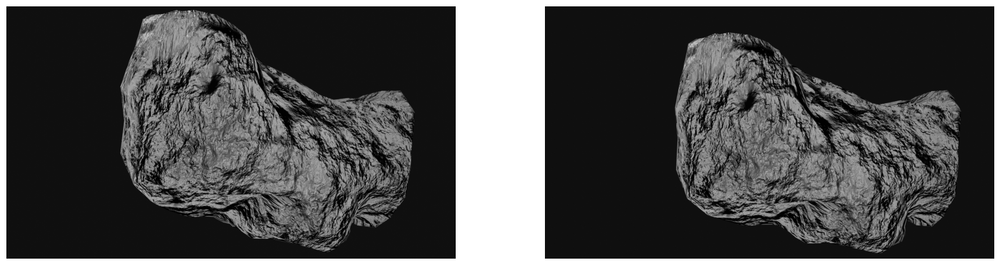

In [3]:
ims = [
    cv.imread(f"{img_folder}/{im_names[i]}.{im_ext}", cv.IMREAD_GRAYSCALE)
    for i in range(2)
]

croppings = [slice(0, 1080), slice(0, 1920), slice(0, 1080), slice(0, 1920)]
ims[0] = ims[0][croppings[0], croppings[1]]
ims[1] = ims[1][croppings[2], croppings[3]]

plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(ims[0], cmap="gray")
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(ims[1], cmap="gray")
plt.axis("off")
plt.show()

In [4]:
# compute float32 versions for calculations
float_ims = [vh.convert_uint8_to_float32(ims[i]) for i in range(2)]

Blur Images


In [5]:
# arbitrary sigma
blur_sigma = 1.0



float_ims = [desc.convolve_2D_gaussian(float_ims[i], blur_sigma) for i in range(2)]

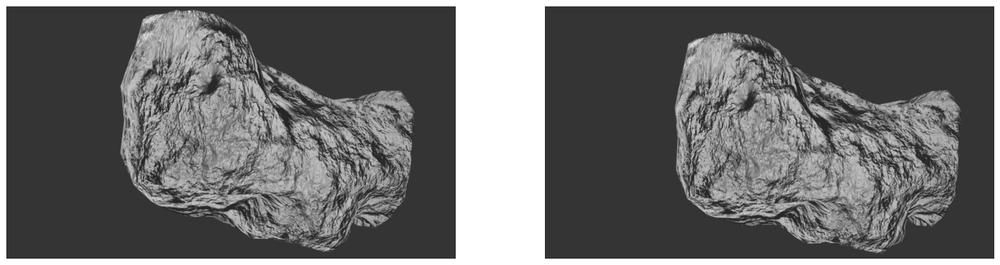

Image 1 min: 0.12339681384076534
Image 1 max: 0.6492288482771411
Image 1 mean: 0.2954878969689037
Image 1 std: 0.0961820863460069
Image 1 shape: (1080, 1920)
Image 1 dtype: float64
Image 1 size: 2073600

Image 2 min: 0.1233968138407653
Image 2 max: 0.6503302792823082
Image 2 mean: 0.2898618107263421
Image 2 std: 0.09338074170101268
Image 2 shape: (1080, 1920)
Image 2 dtype: float64
Image 2 size: 2073600



In [6]:
float_ims[0], float_ims[1] = float_ims

# compute min and max values for normalization
min_val = min(float_ims[0].min(), float_ims[1].min())
max_val = max(float_ims[0].max(), float_ims[1].max())
min_vals, max_vals = [min_val, min_val], [max_val, max_val]

plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(float_ims[0], cmap="gray", vmin=min_val, vmax=max_val)
plt.axis("off")
plt.subplot(1, 2, 2)
plt.imshow(float_ims[1], cmap="gray", vmin=min_val, vmax=max_val)
plt.axis("off")
plt.show()

# print extrema values
for i, im in enumerate(float_ims):
    print(f"Image {i+1} min: {im.min()}")
    print(f"Image {i+1} max: {im.max()}")
    print(f"Image {i+1} mean: {im.mean()}")
    print(f"Image {i+1} std: {im.std()}")
    print(f"Image {i+1} shape: {im.shape}")
    print(f"Image {i+1} dtype: {im.dtype}")
    print(f"Image {i+1} size: {im.size}")
    print("")

# Match SIFT Keypoints on stereo setup


In [7]:
# Initiate SIFT detector
sift = cv.SIFT_create()

# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(ims[0], None)
kp2, des2 = sift.detectAndCompute(ims[1], None)

# print number of keypoints detected in each image
print(f"Number of keypoints detected in {im_name1}: {len(kp1)}")
print(f"Number of keypoints detected in {im_name2}: {len(kp2)}")

Number of keypoints detected in left: 14685
Number of keypoints detected in right: 13623


In [8]:
# BFMatcher with default params
# default norm is L2
bf = cv.BFMatcher()
matches = bf.knnMatch(des1, des2, k=2)

(-0.5, 3839.5, 1079.5, -0.5)

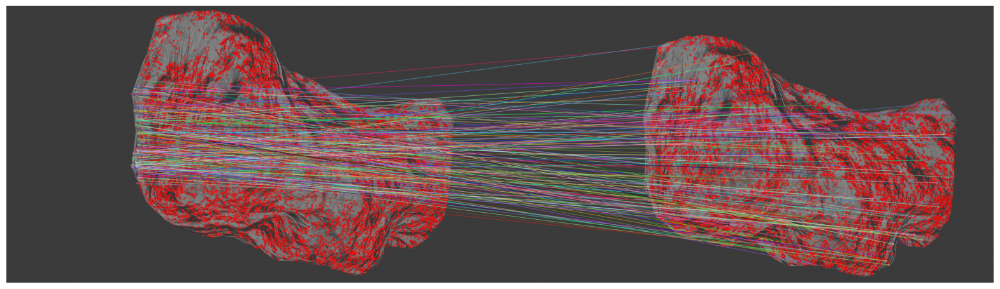

In [9]:
# %%script false
# cv.drawMatchesKnn expects list of lists as matches.
nb_matches_to_draw = 100

img3 = cv.drawMatchesKnn(
    ims[0],
    kp1,
    ims[1],
    kp2,
    matches[:nb_matches_to_draw],
    outImg=None,
    singlePointColor=(255, 0, 0),
)

plt.figure(figsize=(20, 10))
plt.imshow(img3)
plt.axis("off")

## Save keypoints


In [10]:
kp1_filename = img_folder + "keypoints_1.txt"
kp2_filename = img_folder + "keypoints_2.txt"

In [11]:
kp_pairs, matches, kp_1, kp_2 = get_keypoint_pairs(ims[0], ims[1])
save_keypoints(kp_1, kp1_filename)
save_keypoints(kp_2, kp2_filename)
save_matches(matches, img_folder + "matches.txt")
save_kp_pairs_to_arr(kp_pairs, img_folder + "kp_pairs_arr")

[[< cv2.DMatch 0000019B053A3A10>], [< cv2.DMatch 0000019B05393550>], [< cv2.DMatch 0000019B052B27F0>], [< cv2.DMatch 0000019B05393410>], [< cv2.DMatch 0000019B053933D0>], [< cv2.DMatch 0000019B052D9410>], [< cv2.DMatch 0000019B052DB2D0>], [< cv2.DMatch 0000019B052B3870>], [< cv2.DMatch 0000019B05393950>], [< cv2.DMatch 0000019B053A3150>], [< cv2.DMatch 0000019B05320890>], [< cv2.DMatch 0000019B05333E50>], [< cv2.DMatch 0000019B05390B10>], [< cv2.DMatch 0000019B0539B050>], [< cv2.DMatch 0000019B0539A3D0>], [< cv2.DMatch 0000019B052F8C50>], [< cv2.DMatch 0000019B052EA850>], [< cv2.DMatch 0000019B05393590>], [< cv2.DMatch 0000019B05368A90>], [< cv2.DMatch 0000019B05323FD0>], [< cv2.DMatch 0000019B052C8C50>], [< cv2.DMatch 0000019B052C9510>], [< cv2.DMatch 0000019B05333E90>], [< cv2.DMatch 0000019B0539A610>], [< cv2.DMatch 0000019B052D1790>], [< cv2.DMatch 0000019B052E1790>], [< cv2.DMatch 0000019B053A0E50>], [< cv2.DMatch 0000019B05370090>], [< cv2.DMatch 0000019B052F3090>], [< cv2.DMatch

## Post-blender filtering


In [12]:
matches_filename = img_folder + "matches.txt"
matches = load_matches(matches_filename)
idxs = np.load(img_folder + "idxs.npy")
kp1 = load_keypoints(kp1_filename)
kp2 = load_keypoints(kp2_filename)
good_matches = [matches[i] for i in idxs]

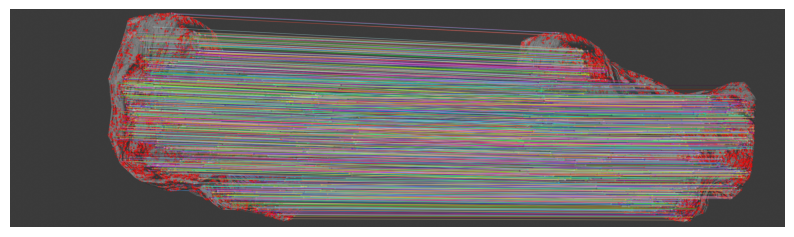

In [13]:
matches_img = cv.drawMatchesKnn(
    # Warning : the number of matches to draw is not specified here
    img1=ims[0],
    keypoints1=kp1,
    img2=ims[1],
    keypoints2=kp2,
    matches1to2=good_matches,
    outImg=None,
    singlePointColor=(255, 0, 0),
)

plt.figure(figsize=(10, 5))
plt.imshow(matches_img)
plt.axis("off")
plt.show()

In [14]:
# proportion of good matches
print(len(good_matches) / len(matches), len(good_matches), len(matches))

0.4159844894442051 3862 9284


# Visualize gradients and curvatures of "good keypoints"


In [15]:
# store keypoints of good matches in 2 lists, 1 per image
good_kp_img1 = []
good_kp_img2 = []

for m in good_matches:
    good_kp_img1.append(kp1[m[0].queryIdx])
    good_kp_img2.append(kp2[m[0].trainIdx])

good_kps = [good_kp_img1, good_kp_img2]

# print lengths of lists
print(f"Number of 'good' matched keypoints in {im_name1}: {len(good_kp_img1)}")
print(f"Number of 'good' matched keypoints in {im_name2}: {len(good_kp_img2)}")

Number of 'good' matched keypoints in left: 3862
Number of 'good' matched keypoints in right: 3862


### Observe 1 "good" SIFT keypoint


In [16]:
kp_index = 1
# kp_index = np.random.randint(0, len(kp_img1))
kp1 = good_kp_img1[kp_index]
kp2 = good_kp_img2[kp_index]
kps = [kp1, kp2]

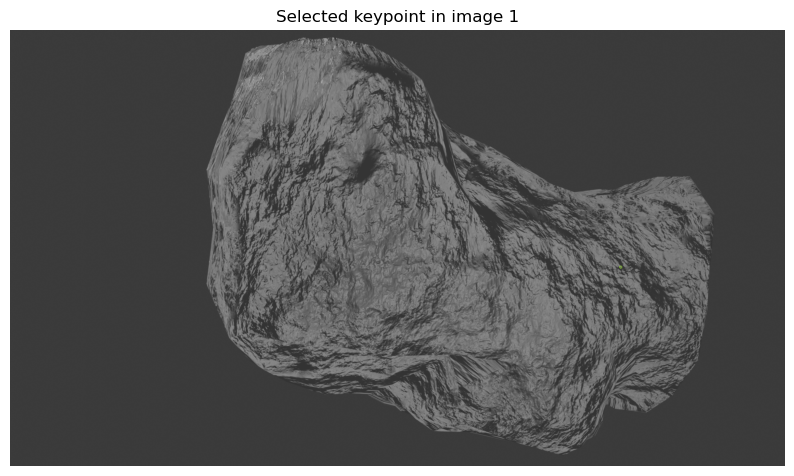

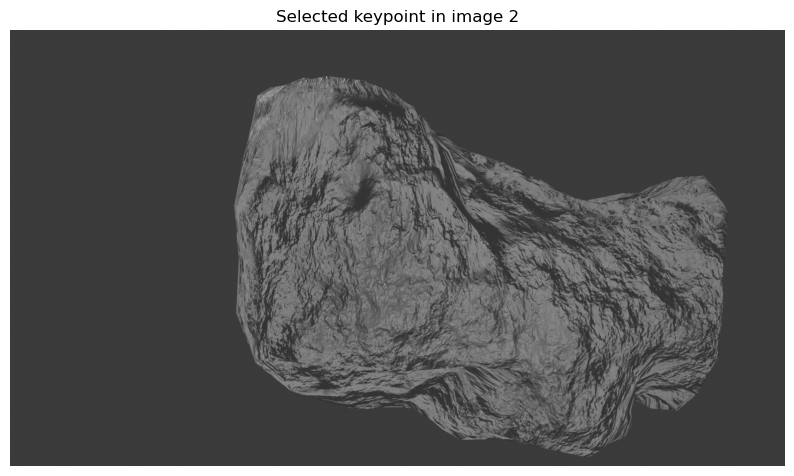

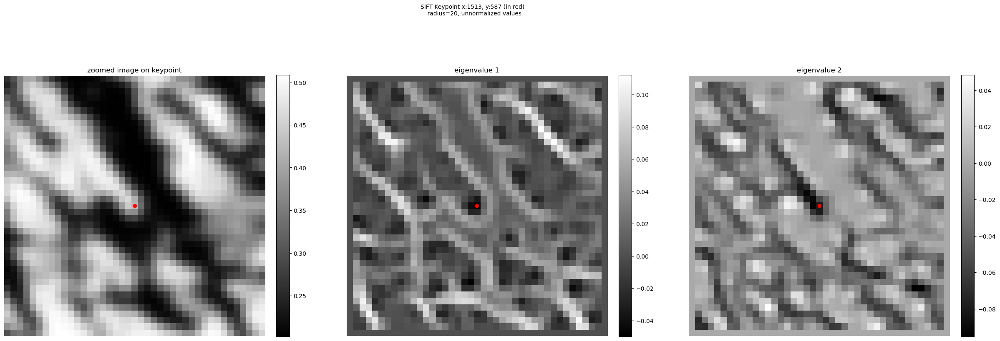

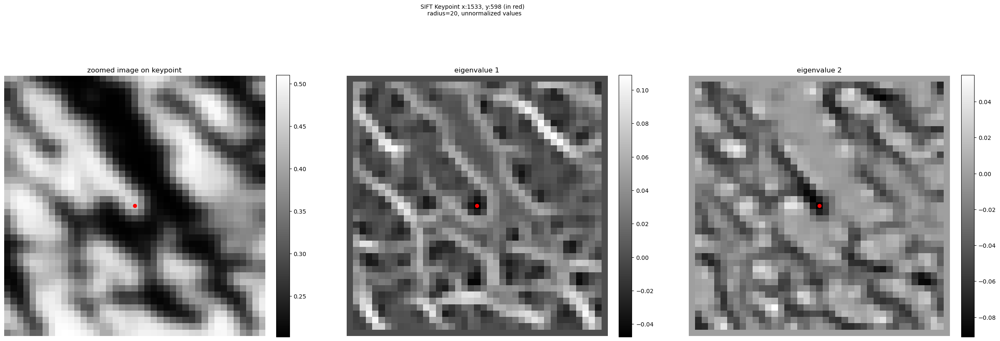

In [17]:
vh.topological_visualization_pipeline(
    kps=kps,
    uint_ims=ims,
    float_ims=float_ims,
    zoom_radius=20,
    figsize=(10, 10),
)

In [ ]:
# %%script false
# draw single keypoint on image 0
kp_img1_draw_single = cv.drawKeypoints(ims[0], [kp1], None, flags=None)
plt.figure(figsize=(20, 20))
plt.imshow(kp_img1_draw_single)
plt.axis("off")
plt.title(f"Selected keypoint in {im_name1}, index: {kp_index}")
# save figure
plt.show()

# draw single keypoint on image 1
kp_img2_draw_single = cv.drawKeypoints(ims[1], [kp2], None, flags=None)
plt.figure(figsize=(20, 20))
plt.imshow(kp_img2_draw_single)
plt.axis("off")
plt.title(f"Selected keypoint in {im_name2}, index: {kp_index}")
# save figure
plt.show()

Show curvature values


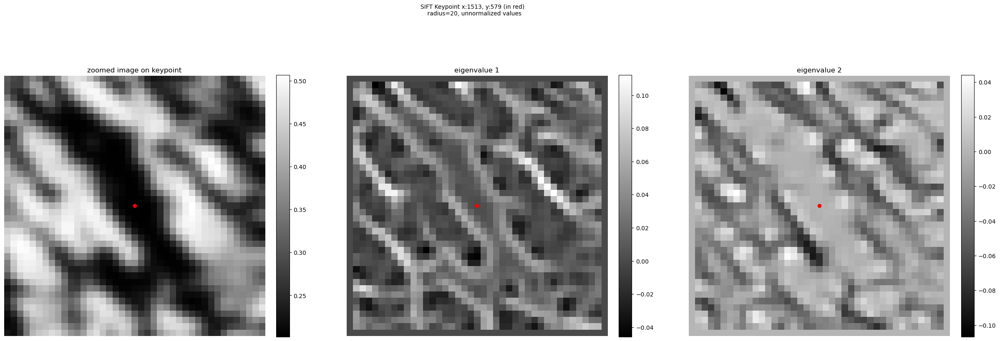

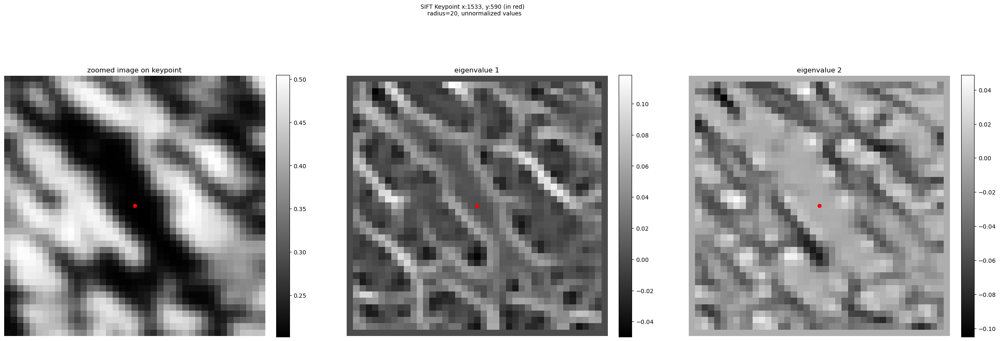

In [ ]:
# %%script false
zoom_radius = 20


# display the figure of curvature values on the float versions

eigval_fig1 = vh.visualize_curvature_values(float_ims[0], kp1, zoom_radius)

plt.figure(eigval_fig1.number)

plt.show()


eigval_fig2 = vh.visualize_curvature_values(float_ims[1], kp2, zoom_radius)

plt.figure(eigval_fig2.number)

plt.show()

Display curvature directions side by side


In [ ]:
# %%script false
dir_fig = vh.compare_directions(
    float_ims[0], float_ims[1], kp1, kp2, zoom_radius, dpi=800
)

# show figure
plt.figure(dir_fig.number)
plt.show()

Show gradients side by side²


In [ ]:
# %%script false
grad_fig = vh.compare_gradients(
    float_ims[0], float_ims[1], kp1, kp2, zoom_radius, dpi=800
)

# show figure
plt.figure(grad_fig.number)
plt.show()

_Observations:_

- High gradient is not necessarily in the keypoint, but can be around him


# Compute histograms descriptors of keypoints


In [ ]:
kp_pos = []
for kp in (kp1, kp2):
    # convert into integer
    pos = np.round(kp.pt).astype(int)
    pos = tuple(pos)
    kp_pos.append(pos)


# define parameters for the descriptor
border_size = 1
feature_radius = zoom_radius + 20

# crop the subimages around keypoints
crop_ims = [
    vh.crop_image_around_keypoint(float_ims[i], kp_pos[i], feature_radius)
    for i in range(2)
]

# compute zoomed positions
zoomed_pos = [feature_radius, feature_radius]

Problem: neighborhood is fixed here by the frame of the image, and not is not an intrinsec feature of the keypoint orientation


## New feature: descriptor rotation with keypoint gradient orientation


In [ ]:
# compute overall features of a subimage of first image
zoomed_features3 = [
    desc.compute_features_overall_abs(crop_ims[i], border_size) for i in range(2)
]

In [ ]:
descriptor_histograms_kps3 = [
    desc.compute_descriptor_histograms_1_2_rotated(zoomed_features3[i], zoomed_pos)
    for i in range(2)
]

TypeError: compute_rotated_vector_histogram() takes from 4 to 8 positional arguments but 9 were given

### Compare descriptors


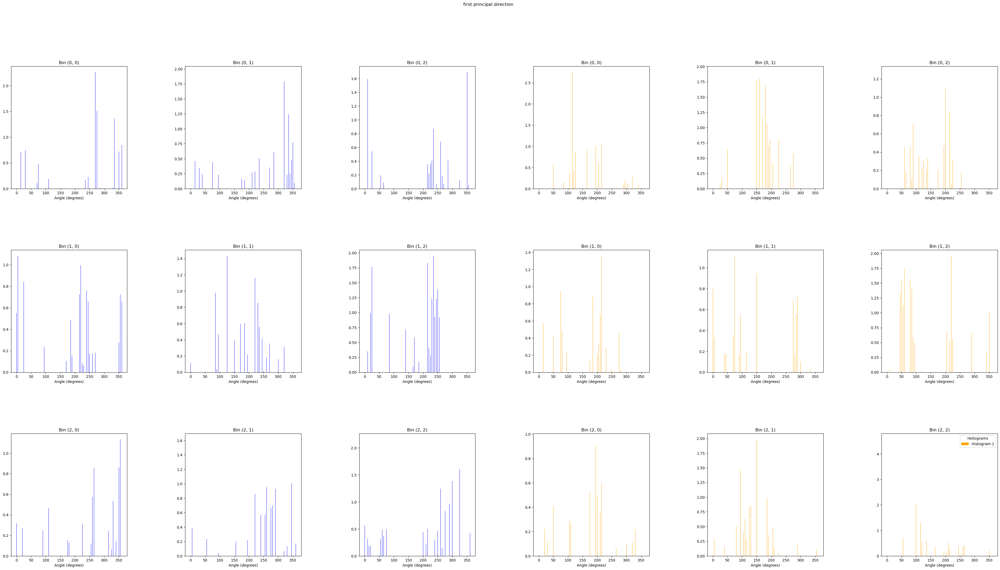

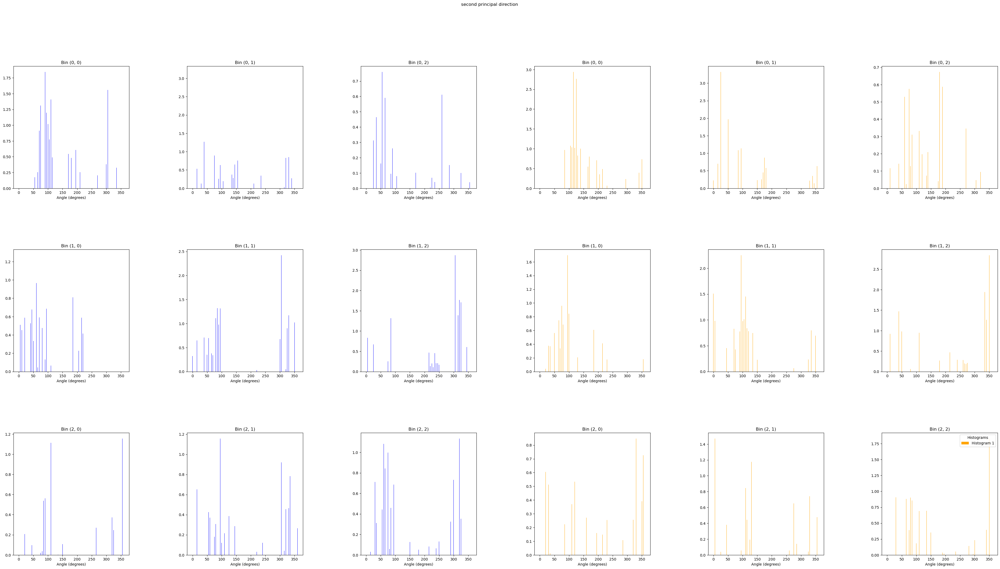

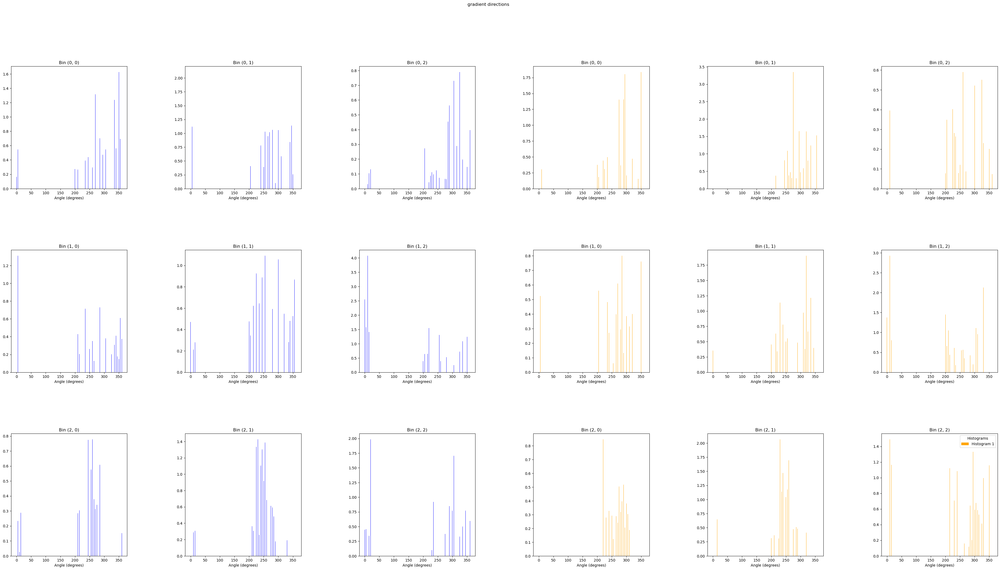

In [ ]:
descriptor_names3 = [f"Descriptor 3 of {im_names[i]}" for i in range(2)]


values_names3 = [
    "first principal direction",
    "second principal direction",
    "gradient directions",
]

for id_feature in range(3):
    visu_desc.display_matched_histograms(
        hist1=descriptor_histograms_kps3[0][id_feature],
        hist2=descriptor_histograms_kps3[1][id_feature],
        hist_title=values_names3[id_feature],
    )

_Observations:_

- first principal direction: upper bin (row 0) differ between left and right


### Compute distance between descriptors


In [ ]:
# %%script false

# flatten the descriptor histograms


flat_descriptor_histograms_kps3 = [
    desc.flatten_descriptor(descriptor_histograms_kps3[i]) for i in range(2)
]


# compute distance between descriptors


dist3 = desc.compute_descriptor_distance(
    flat_descriptor_histograms_kps3[0], flat_descriptor_histograms_kps3[1]
)

dist3

21.856348

Look at distance between the keypoint of the left image and neighbors of the keypoint of the right images


In [ ]:
# %%script false
nb_neighbors = 10
# index of the image where neighbors are computed
im_index = 1
delta_pixel = 10


# generate nb_neighbors random coordinates shifts in 2D


neighbors_shifts3 = np.random.randint(
    -delta_pixel, delta_pixel + 1, size=(nb_neighbors, 2)
)


# compute the neighbor positions


neighbors_positions3 = np.array(kp_pos[im_index]) + neighbors_shifts3


# crop the subimages around neighbors


neighbors_crop_ims3 = [
    vh.crop_image_around_keypoint(
        float_ims[im_index], neighbors_positions3[i], feature_radius
    )
    for i in range(nb_neighbors)
]


# compute overall features of a subimage of second image around the neighbors


neighbors_zoomed_features3 = [
    desc.compute_features_overall_abs(neighbors_crop_ims3[i], border_size)
    for i in range(nb_neighbors)
]


# compute descriptor histograms of the neighbors


neighbors_descriptor_histograms_kps3 = [
    desc.compute_descriptor_histograms_1_2_rotated(
        neighbors_zoomed_features3[i], zoomed_pos
    )
    for i in range(nb_neighbors)
]


# flatten the descriptor histograms


neighbors_flat_descriptor_histograms_kps3 = [
    desc.flatten_descriptor(neighbors_descriptor_histograms_kps3[i])
    for i in range(nb_neighbors)
]


# compute distances between descriptors


neighbors_dists3 = [
    desc.compute_descriptor_distance(
        flat_descriptor_histograms_kps3[0], neighbors_flat_descriptor_histograms_kps3[i]
    )
    for i in range(nb_neighbors)
]

In [ ]:
# print the distances


for i, dist in enumerate(neighbors_dists3):
    print(f"Distance with neighbor {i+1}: {dist:.2f}")

Distance with neighbor 1: 24.12
Distance with neighbor 2: 24.04
Distance with neighbor 3: 24.80
Distance with neighbor 4: 23.91
Distance with neighbor 5: 23.08
Distance with neighbor 6: 23.20
Distance with neighbor 7: 23.97
Distance with neighbor 8: 24.80
Distance with neighbor 9: 23.07
Distance with neighbor 10: 23.07
